# 1. Setup

First, we import the necessary libraries and mount our Google Drive, which contains the input images.

In [2]:
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import tensorflow_datasets as tfds
import tensorflow_hub as hub
import os
from google.colab import drive

In [3]:
drive.mount('/content/drive')

Mounted at /content/drive


Next, we load the VGG19 model, whose weights we will use for transfer learning.

In [4]:
vgg19 = tf.keras.applications.VGG19(include_top=False)
vgg19.trainable = False

80142336/80134624 [==============================] - 1s 0us/step


# 2. Functions for Neural Style Transfer Algorithm

The image_path_to_tensor function takes as an input the path to an image and returns a tensor representing the image. We use 512 x 512 pixels as our default image size.

In [5]:
def image_path_to_tensor(img_path, img_size = (512, 512)):
  image = tf.io.read_file(img_path)
  image = tf.image.decode_image(image, channels=3)
  image = tf.image.convert_image_dtype(image, tf.float32)
  image = tf.image.resize(image, img_size)
  return image

The loss_function function calculates the total loss, given preprocessed versions of the content and style images, the target image, and the weights that we will use for the content and style losses (alpha and beta, respectively). <br>
We use the block_conv2 layer of the VGG19 model as the high-level layer to represent an image's content, and five different layers to represent an image's style. <br>
To calculate the content loss, we take the average square difference of the elements in the feature representation matrices for the content image and the target image. To calculate the style loss, we take the average square difference of the elements in the Gram matrices for the style image and the target image, then aggregate using a simple average across layers. <br>
These loss calculations are similar to those described in the reference paper, but with different scaling, so our alpha and beta values must be adjusted accordingly. We discuss the alpha and beta values in more detail later.

In [ ]:
def loss_function(preprocessed_content, preprocessed_style, target_img, alpha=1, beta=1):
  
  content_layers = ['block5_conv2'] 
  style_layers = ['block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1', 'block5_conv1']

  content_model = tf.keras.Model([vgg19.input], [vgg19.get_layer(layer).output for layer in content_layers])
  style_model = tf.keras.Model([vgg19.input], [vgg19.get_layer(layer).output for layer in style_layers])

  preprocessed_target = tf.keras.applications.vgg19.preprocess_input(target_img*255)
  
  content_features = content_model(tf.expand_dims(preprocessed_content, axis=0))
  target_content_features = content_model(tf.expand_dims(preprocessed_target, axis=0))

  style_features = style_model(tf.expand_dims(preprocessed_style, axis=0))
  target_style_features = style_model(tf.expand_dims(preprocessed_target, axis=0))

  content_loss = tf.math.reduce_mean(tf.math.square(target_content_features - content_features))

  E = []
  for l in range(len(style_features)):
    N = style_features[l].shape[-1]
    M = tf.math.reduce_prod(style_features[l].shape[:-1]).numpy()
    style_features_reshaped = tf.reshape(style_features[l], [M, N])
    A = tf.matmul(style_features_reshaped, style_features_reshaped, transpose_a=True)
    target_style_features_reshaped = tf.reshape(target_style_features[l], [M, N])
    G = tf.matmul(target_style_features_reshaped, target_style_features_reshaped, transpose_a=True)
    E.append(tf.math.reduce_mean(tf.math.square(G - A)))
  style_loss = sum(E) / len(E)

  total_loss = alpha * content_loss + beta * style_loss
  return total_loss

The vgg19_neural_style_transfer function is our main function that takes as inputs the content and style images, as well as several other parameters that govern the learning task. <br>
First, the function initializes the target image, either using random white noise or using the content image. <br>
Then, the function preprocesses the content and style images using the tf.keras.applications.vgg19.preprocess_input() function. <br>
Next, the function runs the optimization algorithm to train the target image tensor, using the loss function as defined in the previous cell. <br>
Finally, the function displays the final target image (unless the user specifies not to) and returns the target image tensor.

In [15]:
def vgg19_neural_style_transfer(content_img, style_img,
                                img_size = (512, 512),
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'random',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-14,
                                show_image = True):
  
  tf.random.set_seed(seed)
  if initialization == 'random':
    target_img = tf.Variable(tf.random.uniform(tf.concat([img_size, [3]], 0)))
  elif initialization == 'content':
    target_img = tf.Variable(content_img)
  else:
    raise ValueError("initialization parameter must be 'random' or 'content'")

  preprocessed_content = tf.keras.applications.vgg19.preprocess_input(content_img*255)
  preprocessed_style = tf.keras.applications.vgg19.preprocess_input(style_img*255)

  for i in range(steps):
    with tf.GradientTape() as tape:
      loss = loss_function(preprocessed_content, preprocessed_style, target_img, alpha, beta)
    grad = tape.gradient(loss, target_img)
    opt.apply_gradients([(grad, target_img)])
    target_img.assign(tf.clip_by_value(target_img, 0.0, 1.0))

  if show_image:
    plt.figure(figsize = (8, 8))
    plt.imshow(target_img.numpy())
    plt.axis('off')
  
  return target_img

# 3. Content and Style Images

Our content images are both inspired by Columbia University - one is the famous Alma Mater statue, while the other is a broader image of the university's campus. <br>
Our style images are a picture of the cartoon character Homer Simpson and Jackson Pollock's painting <i>No. 5, 1948</i>. These images represent very different artistic styles, as the Homer Simpson picture has bright colors separated by distinct black borders, while the Jackson Pollock painting has a darker color palette and a chaotic lack of pattern.

In [ ]:
almamater = image_path_to_tensor('/content/drive/MyDrive/Colab Notebooks/Images/Alma Mater.jpg')
columbia = image_path_to_tensor('/content/drive/MyDrive/Colab Notebooks/Images/Columbia.jpg')
simpson = image_path_to_tensor('/content/drive/MyDrive/Colab Notebooks/Images/Simpson.jpg')
pollock = image_path_to_tensor('/content/drive/MyDrive/Colab Notebooks/Images/Pollock.jpg')

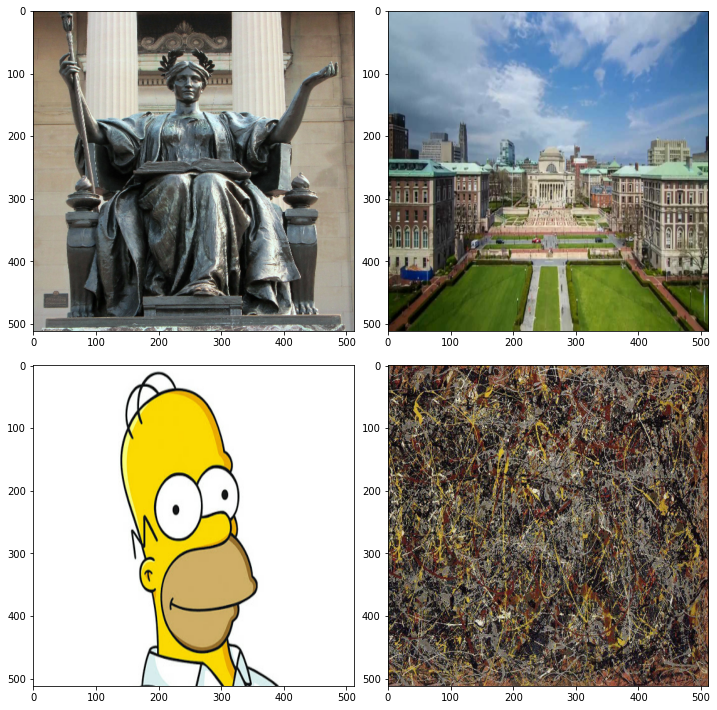

In [ ]:
fig, ax = plt.subplots(2, 2, figsize=(10, 10))
ax[0, 0].imshow(almamater.numpy())
ax[0, 1].imshow(columbia.numpy())
ax[1, 0].imshow(simpson.numpy())
ax[1, 1].imshow(pollock.numpy())
plt.tight_layout()

# 4. Main Output

In this section, we show four images generated by the algorithm described above, combining the content images and the style images. The images in this section were all generated using the content image to initialize the target, running 100 training steps with alpha = 1 and beta = 1e-14, but we will vary these parameters in later sections.

The first image combines the content of the Alma Mater statue picture with the Homer Simpson style. As we can see below, the image now shows Alma Mater with the crisp black outlines and mostly white & yellow color palette of the Homer Simpson image. 

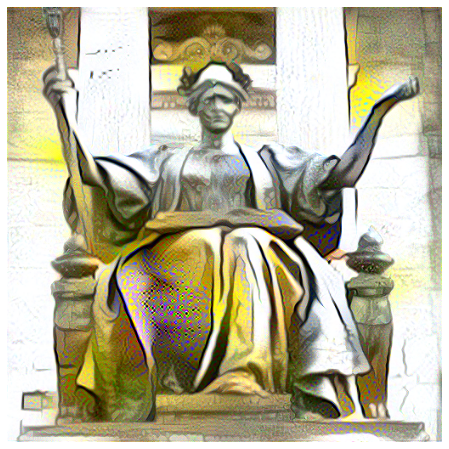

In [ ]:
target = vgg19_neural_style_transfer(almamater, simpson,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-14)

The second image combines the content of the Alma Mater statue picture with Jackson Pollock's style. Here, Alma Mater is rendered with the darker colors and disorderly (lack of) pattern for which Pollock is known.

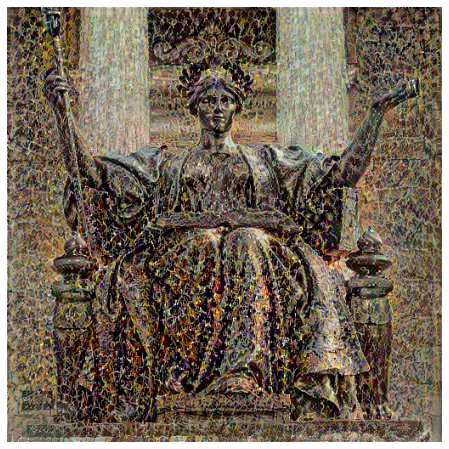

In [ ]:
target = vgg19_neural_style_transfer(almamater, pollock,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-14)

The third image combines the content of the Columbia campus picture with the Homer Simpson style. Again, we see the crisp outlines and bright white & yellow colors from this distinctive style.

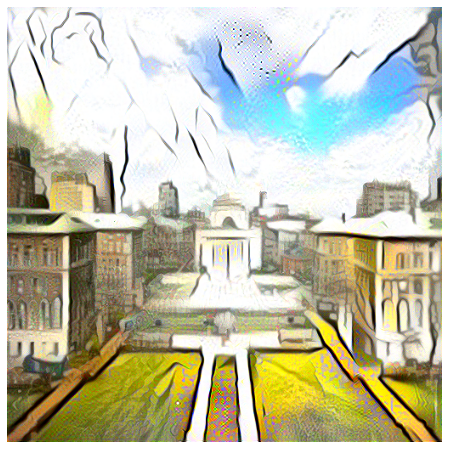

In [ ]:
target = vgg19_neural_style_transfer(columbia, simpson,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-14)

The fourth image combines the content of the Columbia campus picture with Jackson Pollock's style. As we would expect, here the campus looks much darker and less orderly.

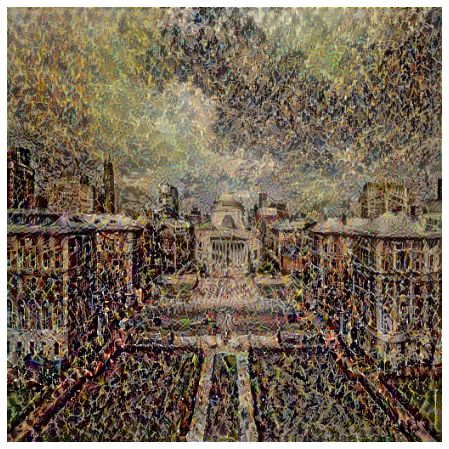

In [ ]:
target = vgg19_neural_style_transfer(columbia, pollock,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-14)

# 5. Varying the Number of Training Iterations

In this section, we explore the evolution of the learning process after different numbers of training iterations (10, 25, 50, 75, and 100 steps). For illustrative purposes, we select two of the four combinations: Alma Mater + Homer Simpson, and Columbia Campus + Jackson Pollock.

For the Alma Mater + Homer Simpson combination, we can see a clear progression of the style seeping into the content (recall that we are still initializing the target image using the content image). After 10 steps, the color palette has barely begun to transform. After 25 steps, the black outlines are forming and some of the white spaces are getting whiter. This process continues, adding the distinctive yellow coloring as well, as we go through more training steps. Between the 75-step and 100-step images, the returns are diminishing, with the latter image having only marginally brighter yellows and clearer white spaces.

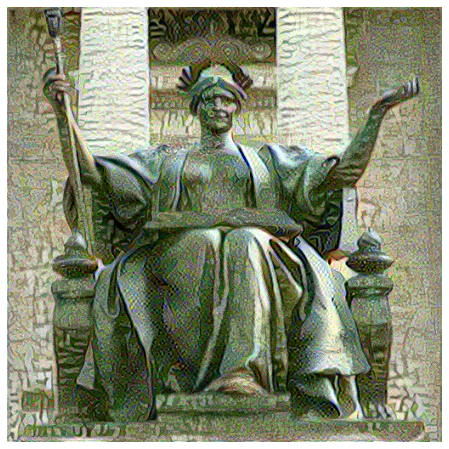

In [ ]:
target = vgg19_neural_style_transfer(almamater, simpson,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 10, 
                                alpha = 1, 
                                beta = 1e-14)

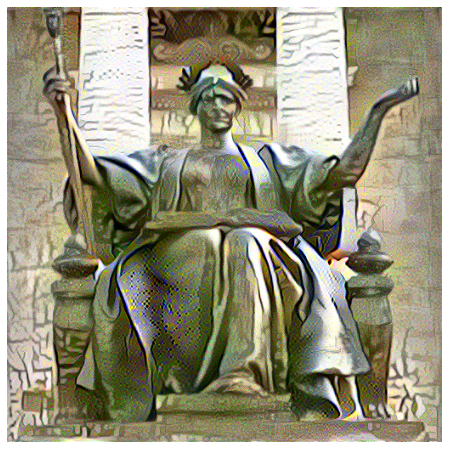

In [ ]:
target = vgg19_neural_style_transfer(almamater, simpson,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 25, 
                                alpha = 1, 
                                beta = 1e-14)

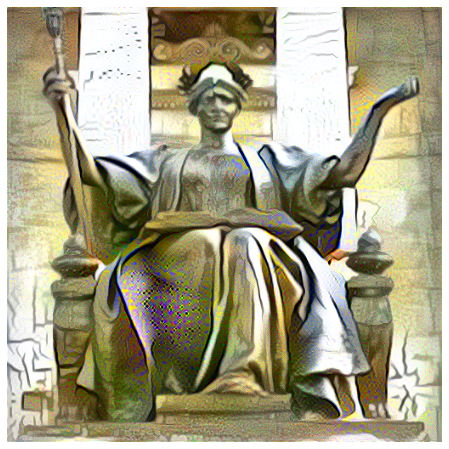

In [ ]:
target = vgg19_neural_style_transfer(almamater, simpson,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 50, 
                                alpha = 1, 
                                beta = 1e-14)

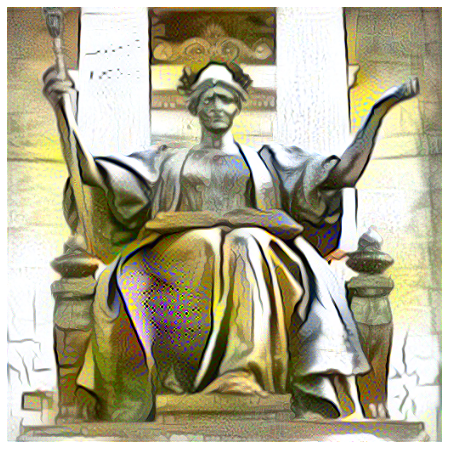

In [ ]:
target = vgg19_neural_style_transfer(almamater, simpson,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 75, 
                                alpha = 1, 
                                beta = 1e-14)

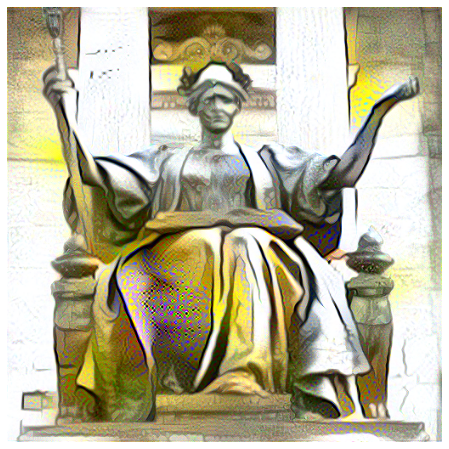

In [ ]:
target = vgg19_neural_style_transfer(almamater, simpson,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-14)

For the Columbia Campus + Jackson Pollock combination, we also see a progression as the steps go by, though the target image seems to stabilize sooner. To the naked eye, there is not much difference between the 50-step, 75-step, and 100-step images.

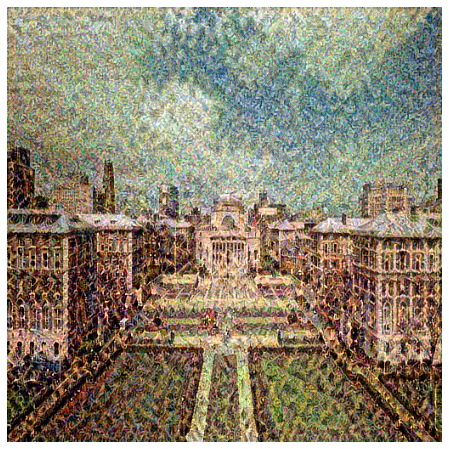

In [ ]:
target = vgg19_neural_style_transfer(columbia, pollock,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 10, 
                                alpha = 1, 
                                beta = 1e-14)

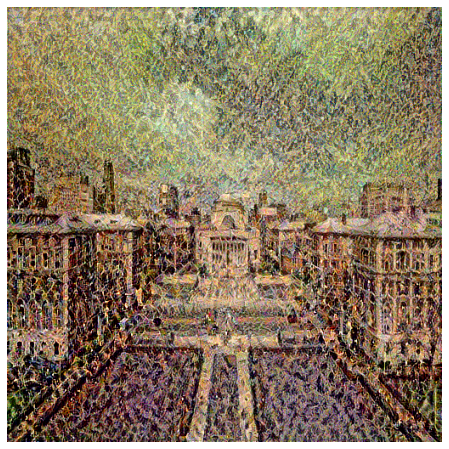

In [ ]:
target = vgg19_neural_style_transfer(columbia, pollock,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 25, 
                                alpha = 1, 
                                beta = 1e-14)

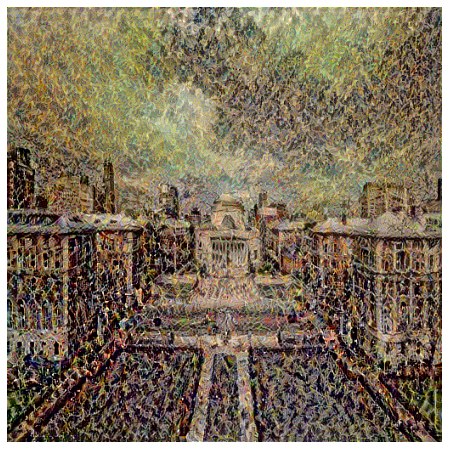

In [ ]:
target = vgg19_neural_style_transfer(columbia, pollock,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 50, 
                                alpha = 1, 
                                beta = 1e-14)

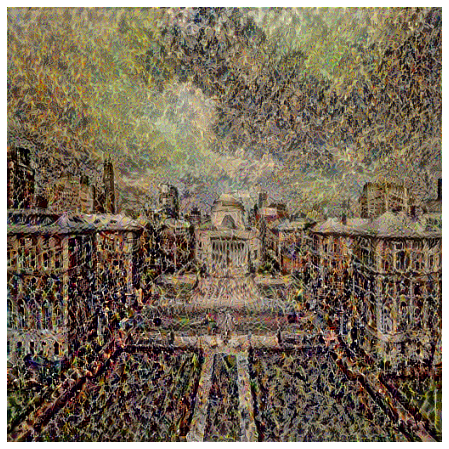

In [ ]:
target = vgg19_neural_style_transfer(columbia, pollock,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 75, 
                                alpha = 1, 
                                beta = 1e-14)

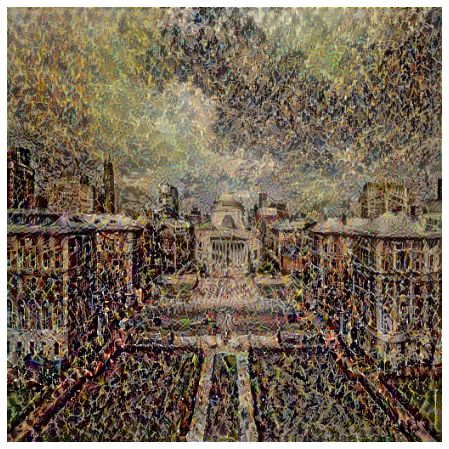

In [ ]:
target = vgg19_neural_style_transfer(columbia, pollock,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-14)

# 6. Varying the Target Image Initialization

In this section, we look at the same two combinations as before, exploring different ways of initializing the target image. Here, we compare initializing  with the content image to initializing with random white noise, and compare different random seeds for the white noise.

For the Alma Mater + Homer Simpson combination, initializing with the content image gives us a much clearer picture of the Alma Mater statue. While initializing with random white noise still gives us a recognizable pattern, the outline is not nearly as crisp. Using different random seeds gives us different-looking images, though unsurprisingly neither is observably "better" than the other.

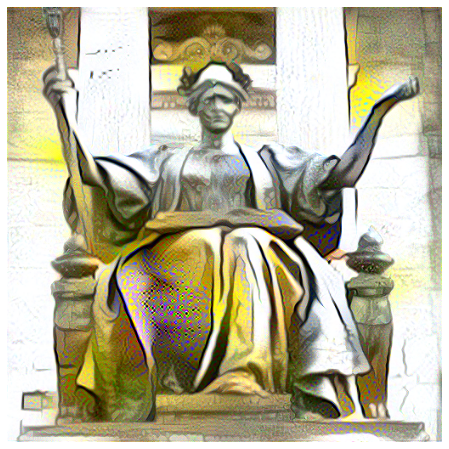

In [ ]:
target = vgg19_neural_style_transfer(almamater, simpson,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-14)

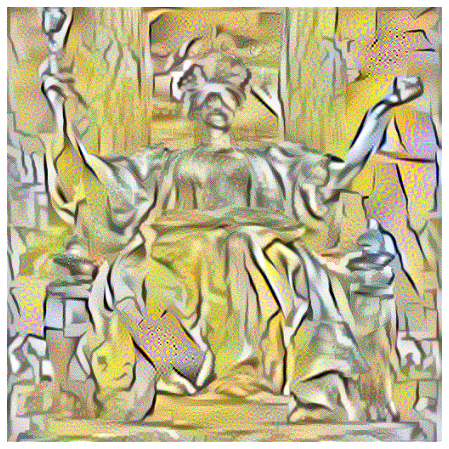

In [ ]:
target = vgg19_neural_style_transfer(almamater, simpson,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'random',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-14)

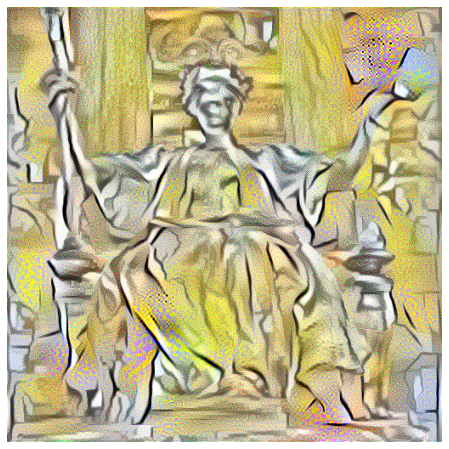

In [ ]:
target = vgg19_neural_style_transfer(almamater, simpson,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'random',
                                seed = 1,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-14)

For the Columbia Campus + Jackson Pollock combination, we also see that initializing with the content image gives us a clearer picture of the campus. The difference is perhaps more apparent here, as the random initializations only have very vague building shapes. This is likely because of the style itself; Pollock's method of creating the artwork via paint drip is itself a somewhat random process, so the random initialization is more similar to the style image than to the content image. Therefore, the optimization process approaches a local minimum for the loss function that is better for the style loss than the content loss.

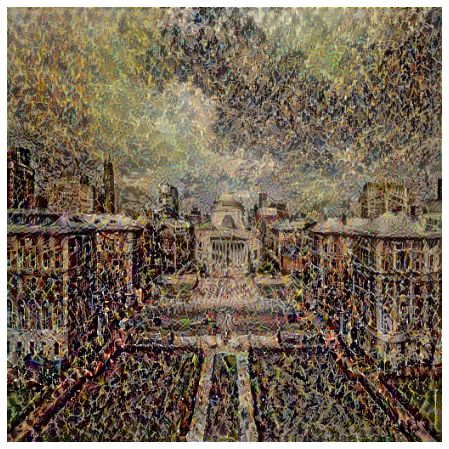

In [ ]:
target = vgg19_neural_style_transfer(columbia, pollock,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-14)

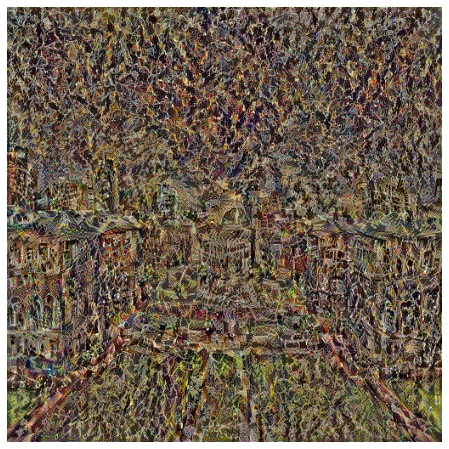

In [ ]:
target = vgg19_neural_style_transfer(columbia, pollock,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'random',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-14)

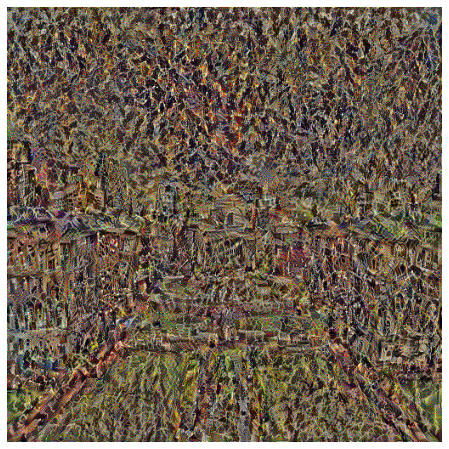

In [ ]:
target = vgg19_neural_style_transfer(columbia, pollock,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'random',
                                seed = 1,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-14)

The takeaway from this experimentation is that initializing the target image with the content image gives us output that more closely adheres to the shapes in the content image. Initializing with random white noise, on the other hand, gives the output a more amorphous shape, which can look different if we use different random seeds.

# 7. Varying the Content vs. Style Loss Weights

In this section, we explore how the output images look when we use different combinations of content loss (alpha) and style loss (beta). Recall from earlier that our content loss and style loss functions are scaled differently than those in the reference paper, so the ratios of alpha to beta may be different. While we experimented with many different combinations, for illustrative purposes we will show alpha = 1 with beta = 1e-13, 1e-14, and 1e-15.

For the Alma Mater + Homer Simpson combination, there are clear differences between these three parameter choices. <br>
- With beta = 1e-13, many of the statue's features have been washed away, with only the basic outlines remaining. Since this is the example where the style loss receives the highest weight, it is unsurprising that this image looks the most "cartoony".
- With beta = 1e-14, we see more of the statue's finer features, and the yellow & white color palette is not as sharp.
- With beta = 1e-15, we see very little of the Homer Simpson style. This weighting seems to tilt too heavily toward the content loss.

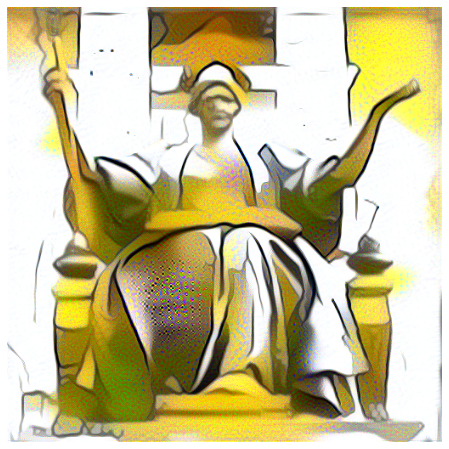

In [ ]:
target = vgg19_neural_style_transfer(almamater, simpson,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-13)

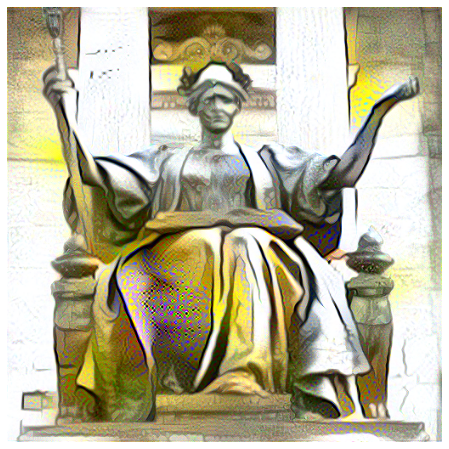

In [ ]:
target = vgg19_neural_style_transfer(almamater, simpson,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-14)

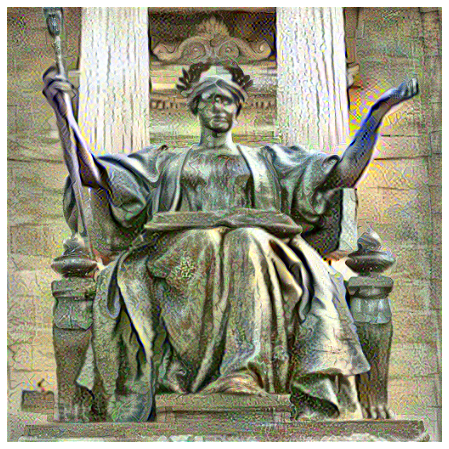

In [ ]:
target = vgg19_neural_style_transfer(almamater, simpson,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-15)

For the Columbia Campus + Jackson Pollock combination, the parameter choices still have an impact, but it is not quite as obvious as it was in the previous example. All three images are reminiscent of Pollock's chaotic splashes of paint, but the color palette is darker when the style loss has greater weight (beta = 1e-13) and more colorful (like the content image) when the style loss has less weight (beta = 1e-15).

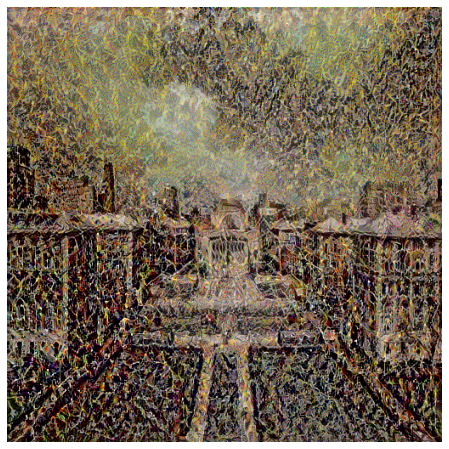

In [ ]:
target = vgg19_neural_style_transfer(columbia, pollock,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-13)

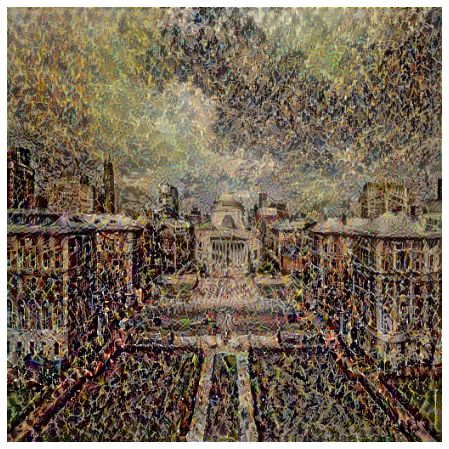

In [ ]:
target = vgg19_neural_style_transfer(columbia, pollock,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-14)

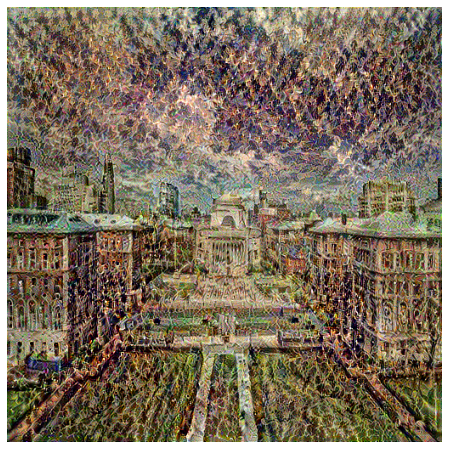

In [ ]:
target = vgg19_neural_style_transfer(columbia, pollock,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-15)

Based on this analysis, it is clear that giving more relative weight to the style loss injects more of the style (and less of the content) into the final image, and vice versa. From our experimentation, we empirically observed that a beta-to-alpha ratio on the order of 1e-14 seems to strike the best balance.

# 8. Commentary on Other Style Image Examples

Beyond the examples shown above, we explored many other artistic styles, some of which were more successful than others in blending with the content images. Based on this experimentation, we noticed an interesting pattern: The style images that worked best for these combinations tended to be those with distinctive color palettes (e.g. Homer Simpson's bright white and yellow, or Jackson Pollock's dreary browns) and recognizable characteristics (e.g. Homer Simpson's sharp borders, or Jackson Pollock's random splatter). On the other hand, the style images that did not work as well tended to be those with a greater variety of shades and more diversity of shapes within the composition.

One example of a style image that did not work as well is Salvador Dali's <i>The Persistence of Memory</i>. This painting is known for its surreal depiction of melting clocks against a rocky background. However, these qualities do not translate well when run through the algorithm, perhaps because the shapes in the painting all have somewhat different characteristics (e.g. sharp edges in the landscape but flaccidity and roundness in the clocks).

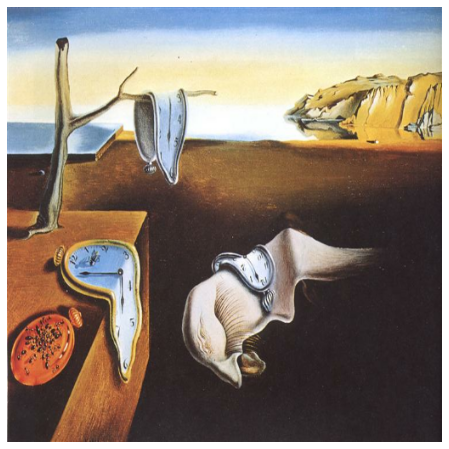

In [ ]:
dali = image_path_to_tensor('/content/drive/MyDrive/Colab Notebooks/Images/Dali.jpg')
plt.figure(figsize = (8, 8))
plt.imshow(dali.numpy())
axes = plt.axis('off')

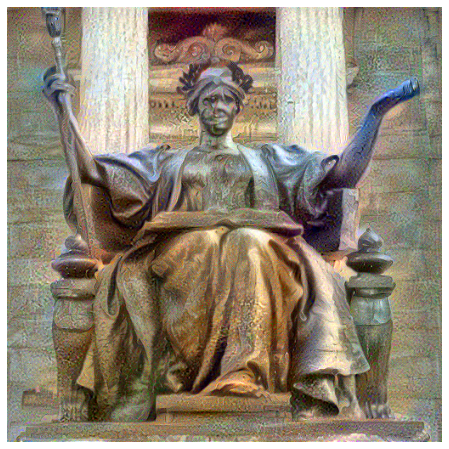

In [ ]:
target = vgg19_neural_style_transfer(almamater, dali,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-14)

Another example of a style image that did not work as well is Michelangelo Merisi da Caravaggio's <i>Supper at Emmaus</i>. Caravaggio is known for using shading and shadow to elicit an almost photorealistic appearance. However, this technique is difficult for the algorithm to learn, as it requires a very specific way of blending of many shades.

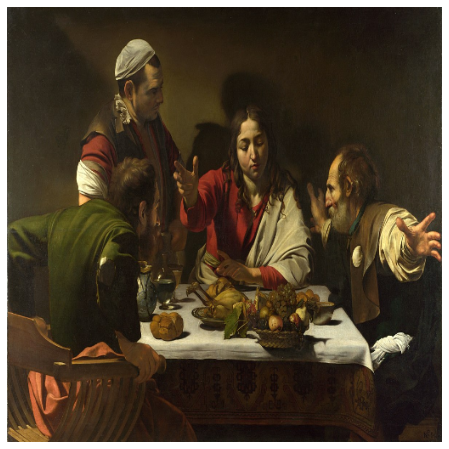

In [ ]:
caravaggio = image_path_to_tensor('/content/drive/MyDrive/Colab Notebooks/Images/Caravaggio.jpg')
plt.figure(figsize = (8, 8))
plt.imshow(caravaggio.numpy())
axes = plt.axis('off')

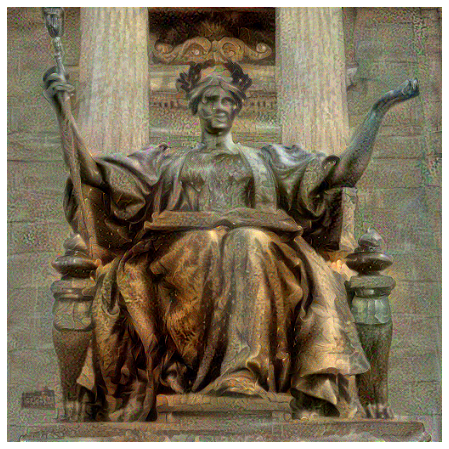

In [ ]:
target = vgg19_neural_style_transfer(almamater, caravaggio,
                                opt = tf.optimizers.Adam(learning_rate = 0.1), 
                                initialization = 'content',
                                seed = 0,
                                steps = 100, 
                                alpha = 1, 
                                beta = 1e-14)